In [1]:
%tensorflow_version 2.x
import tensorflow as tf
import numpy as np
import os
import time
import functools
from IPython import display as ipythondisplay
from tqdm import tqdm
!apt-get install abcmidi timidity > /dev/null 2>&1

Colab only includes TensorFlow 2.x; %tensorflow_version has no effect.


In [ ]:
!pip install mitdeeplearning
import mitdeeplearning as mdl

     |████████████████████████████████| 2.1 MB 4.2 MB/s 
  Created wheel for mitdeeplearning: filename=mitdeeplearning-0.2.0-py3-none-any.whl size=2115442 sha256=a6a3a964cef4c5b41b40281d02ff7b17ae69c5d88fc8a59158619f7ac002556f
  Stored in directory: /root/.cache/pip/wheels/9a/b9/4f/99b7c8c5c75355550b83e1fcfc02956fb40c35eb01e2262877
Successfully built mitdeeplearning


In [ ]:
with open('jigs.txt') as f:
    string = f.read()
    jigs = string.split("\n\n\n")

with open('carrols.txt') as f:
    string = f.read()
    carrols = string.split("\n\n\n")

with open('hornpipes.txt') as f:
    string = f.read()
    hornpipes = string.split("\n\n\n")

with open('morris.txt') as f:
    string = f.read()
    morris = string.split("\n\n\n")

with open('playford.txt') as f:
    string = f.read()
    playford = string.split("\n\n\n")

with open('waltzes.txt') as f:
    string = f.read()
    waltzes = string.split("\n\n\n")

songs = []

for i in [jigs, carrols, hornpipes, morris, playford, waltzes]:
  for j in i:
    songs.append(j)

songs

In [ ]:
songs_new = []

for i in range(4):
  for song in songs:
    if song[0] == '\n':
      songs_new.append(song[1:])
    else:
      songs_new.append(song)

songs_new

In [ ]:
mdl.lab1.play_song(songs_new[-1])

In [ ]:
# CONCATENATING ALL SONGS IN SONGS_NEW LIST TOGETHER
all_songs = "\n\n".join(songs_new)


# CREATING A VOCABULARY FOR SONGS BY FINDING ALL UNIQUE CHARACTERS
vocab = sorted(set(all_songs))

# CREATING INDEX FOR EACH UNIQUE CHARACTER
char_ind = {i:j for j, i in enumerate(vocab)}

# CREATING INVERSE OF CHAR_IDX TO CONVERT BACK THE INDICES TO CHARACTERS LATER
ind_char = np.array(vocab)

In [ ]:
# WE NEED TO CONVERT THE TEXTUAL DATA INTO NUMERICAL DATA IN ORDER FOR IT'S CONVERSION

text_to_numerical_songs = np.array([char_ind[char] for char in all_songs])

In [ ]:
text_to_numerical_songs.shape

(789774,)

In [ ]:
# CREATING A FUNCTION TO GENERATE INPUT AND OUTPUT BATCH SEQUENCES

def generate_batches(songs, sequence_length, batch_size):

  l = songs.shape[0] - 1

  # RANDOMLY ALOTTING INDICES FOR GENERATING BATCHES
  indices = np.random.choice(l-sequence_length, batch_size)

  X = [songs[i : i+sequence_length] for i in indices]

  # SHIFTING THE INPUT SEQUENCES BY ONE CHARACTER TO THE RIGHT
  y = [songs[i+1 : i+sequence_length+1] for i in indices]

  X = np.reshape(X, [batch_size, sequence_length])
  y = np.reshape(y, [batch_size, sequence_length])

  return X, y

In [ ]:
# SETTING UP HYPERPARAMETERS

vocab_size = len(vocab)
batch_size = 32
lstm_units = 1024
embedding_dim = 256
sequence_length = 128
learning_rate = 5e-3
num_training_iterations = 2000

In [ ]:
# CREATING A LSTM MODEL USING TENSORFLOW SEQUENTIAL API

model = tf.keras.Sequential([
    tf.keras.layers.Embedding(vocab_size, embedding_dim, batch_input_shape=[batch_size, None]),
    tf.keras.layers.LSTM(lstm_units, return_sequences=True, recurrent_initializer='glorot_uniform', recurrent_activation='sigmoid', stateful=True),
    tf.keras.layers.Dense(vocab_size)
  ])

# PRINTING OUT THE SUMMARY OF THE MODEL
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding (Embedding)        (32, None, 256)           22528     
_________________________________________________________________
lstm (LSTM)                  (32, None, 1024)          5246976   
_________________________________________________________________
dense (Dense)                (32, None, 88)            90200     
Total params: 5,359,704
Trainable params: 5,359,704
Non-trainable params: 0
_________________________________________________________________


In [ ]:
# CREATING TRAINING INPUT AND OUTPUT SEQUENCES

X, y = generate_batches(text_to_numerical_songs, sequence_length, batch_size)

In [ ]:
# DEFINING LOSS FOR OUT LSTM MODEL

def compute_loss(labels, logits):
  loss = tf.keras.losses.sparse_categorical_crossentropy(labels, logits, from_logits=True)

  return loss

In [ ]:
# CREATING A DIRECTORY FOR STORING THE MODEL WEIGHTS

checkpoint_directory = './trained_weights'
weights = os.path.join(checkpoint_directory, "weights")

In [ ]:
# SETTING OPTIMIZER AS ADAM

optimizer = tf.keras.optimizers.Adam(learning_rate)

@tf.function
def train_step(x, y):

  with tf.GradientTape() as tape:
    y_hat = model(x)
    loss = compute_loss(y, y_hat)

  # PERFORMING GRADIENT DESCENT AND UPDATING THE MODEL WEIGHTS

  grads = tape.gradient(loss, model.trainable_variables)
  optimizer.apply_gradients(zip(grads, model.trainable_variables))

  # RETURNING THE NEW LOSS
  return loss

history = []

for i in range(num_training_iterations):

  print("Number of Iterations completed : ", i)
  X, y = generate_batches(text_to_numerical_songs, sequence_length, batch_size)
  loss = train_step(X, y)

  history.append(loss.numpy().mean())


model.save_weights(weights)


Text(0.5, 1.0, 'LOSS VS EPOCHS')

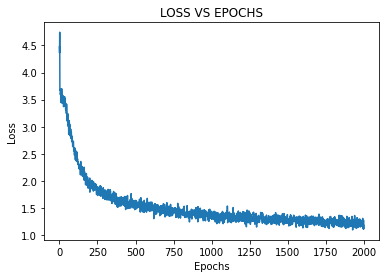

In [ ]:
# PLOTTING THE LOSS VS EPOCHS GRAPH

import matplotlib.pyplot as plt

epochs = np.array([i for i in range(num_training_iterations)])

plt.plot(epochs, history)
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("LOSS VS EPOCHS")

In [ ]:
# RUN THE NOTEBOOK CELLS FROM HERE TO USE THE PRE-TRAINED WEIGHTS

In [ ]:
!git clone https://github.com/PrinceShishodia/AI_MelodyMaker.git

Cloning into 'Music_Generation_Using_LSTM'...
remote: Enumerating objects: 24, done.
remote: Counting objects: 100% (24/24), done.
remote: Compressing objects: 100% (21/21), done.
remote: Total 24 (delta 1), reused 21 (delta 1), pack-reused 0
Unpacking objects: 100% (24/24), done.


In [ ]:
checkpoint_directory = '/content/AI_MelodyMaker/trained_weights'
#weights = os.path.join(checkpoint_directory, "weights")

In [ ]:
# PRE-LOADING THE WEIGHTS OF MODEL AND INITIALIZING BATCH SIZE AS 1

model = tf.keras.Sequential([
    tf.keras.layers.Embedding(vocab_size, embedding_dim, batch_input_shape=[1, None]),
    tf.keras.layers.LSTM(lstm_units, return_sequences=True, recurrent_initializer='glorot_uniform', recurrent_activation='sigmoid', stateful=True),
    tf.keras.layers.Dense(vocab_size)
  ])

model.load_weights(tf.train.latest_checkpoint(checkpoint_directory))
model.build(tf.TensorShape([1, None]))

model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding (Embedding)        (1, None, 256)            22528     
_________________________________________________________________
lstm (LSTM)                  (1, None, 1024)           5246976   
_________________________________________________________________
dense (Dense)                (1, None, 88)             90200     
Total params: 5,359,704
Trainable params: 5,359,704
Non-trainable params: 0
_________________________________________________________________


In [ ]:
def generate_text(model, start_string, generation_length=1000):

  # CREATING A INPUT SEQUENCE WITH THE PROVIDED STARTING STRING
  input_eval = [char_ind[s] for s in start_string]

  input_eval = tf.expand_dims(input_eval, 0)

  text_generated = []
  model.reset_states()


  for i in range(generation_length):

      # PREDICTING THE OUTPUT SEQUENCE

      predictions = model(input_eval)
      predictions = tf.squeeze(predictions, 0)

      predicted_id = tf.random.categorical(predictions, num_samples=1)[-1,0].numpy()
      input_eval = tf.expand_dims([predicted_id], 0)

      # CONVERTING THE NUMERICAL SEQUENCE BACK TO CHARACTERS IN THE VOCABULARY
      text_generated.append(ind_char[predicted_id])

  # RETURNING THE CHARACTER SEQUENCE
  return (start_string + ''.join(text_generated))

In [ ]:
for j in range(10):
  generated_text = generate_text(model, start_string="X", generation_length=500)
  generated_songs = mdl.lab1.extract_song_snippet(generated_text)
  for i, song in enumerate(generated_songs):
    waveform = mdl.lab1.play_song(song)
    ipythondisplay.display(waveform)

Found 1 songs in text


None

Found 1 songs in text


Found 1 songs in text


None

Found 2 songs in text


None

None

Found 1 songs in text


None

Found 0 songs in text
Found 0 songs in text
Found 0 songs in text
Found 1 songs in text


None

Found 1 songs in text


None